# Feature Matching

- 학번 : 20233142
- 이름 : 박정은

---

OpenCV를 사용하여 feature description을 얻어내고, 이를 이용해 feature matching을 진행한다.

- 지난 시간에 얻은 ORB feature, SIFT feature 등에 대한 description을 얻어낸다.
- 이를 이용해 두 이미지 간의 feature matching을 진행한다.


**참고**

- [OpenCV tutorial - Feature Detection and Description](https://docs.opencv.org/master/db/d27/tutorial_py_table_of_contents_feature2d.html)
- [OpenCV document](https://docs.opencv.org/3.4/d0/d13/classcv_1_1Feature2D.html#a8be0d1c20b08eb867184b8d74c15a677)
- Colab에서 코드에 이상이 없음에도 불구하고 결과가 제대로 나오지 않을 경우, '런타임 다시 시작...'을 해보도록 한다.

---

**[중요] 과제 제출 방법**
- 과제 제출 기한은 가상대학 공지사항을 참고하세요.
- 과제는 Colab에서 작성한 것을 다운받아 (파일 > 다운로드 > .ipynb 다운로드) 가상 대학에 업로드합니다. (이외의 제출 방법은 인정하지 않음)
- 제출 시 파일 제목은 '학번_이름' 으로 저장합니다.

# OpenCV 버전 변경

SIFT, SURF Feature 사용을 위해 현재 Colab 서버에 설치되어 있는 OpenCV 버전을 변경한다.

In [1]:
!pip3 uninstall opencv-python
!pip3 uninstall opencv-contrib-python
!pip3 install opencv-contrib-python==3.4.18.65

Found existing installation: opencv-python 4.8.0.76
Uninstalling opencv-python-4.8.0.76:
  Would remove:
    /usr/local/lib/python3.10/dist-packages/cv2/*
    /usr/local/lib/python3.10/dist-packages/opencv_python-4.8.0.76.dist-info/*
    /usr/local/lib/python3.10/dist-packages/opencv_python.libs/libQt5Core-39545cc7.so.5.15.0
    /usr/local/lib/python3.10/dist-packages/opencv_python.libs/libQt5Gui-a7aedf18.so.5.15.0
    /usr/local/lib/python3.10/dist-packages/opencv_python.libs/libQt5Test-c38a5234.so.5.15.0
    /usr/local/lib/python3.10/dist-packages/opencv_python.libs/libQt5Widgets-e69d94fb.so.5.15.0
    /usr/local/lib/python3.10/dist-packages/opencv_python.libs/libQt5XcbQpa-5b2d853e.so.5.15.0
    /usr/local/lib/python3.10/dist-packages/opencv_python.libs/libX11-xcb-69166bdf.so.1.0.0
    /usr/local/lib/python3.10/dist-packages/opencv_python.libs/libXau-00ec42fe.so.6.0.0
    /usr/local/lib/python3.10/dist-packages/opencv_python.libs/libavcodec-402e4b05.so.59.37.100
    /usr/local/lib/py

In [2]:
import sys
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

print('python', sys.version)
print('numpy', np.__version__)
print('opencv', cv.__version__)

python 3.10.12 (main, Nov 20 2023, 15:14:05) [GCC 11.4.0]
numpy 1.25.2
opencv 3.4.18


In [3]:
# mount
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
ROOT = '/content/drive/My Drive/Colab Notebooks/Vehicle Intelligence/work1/'

### opencv를 사용해 이미지 불러오기

- `cv.imread()`를 이용해 이미지를 불러오면 RGB가 아닌 BGR 이미지임을 유의해야 한다.

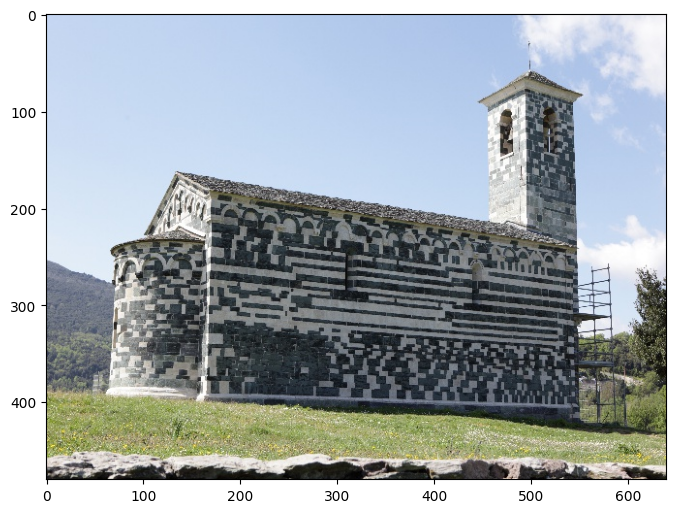

In [5]:
img = cv.imread(ROOT + 'feature/DPP_0010.JPG')

plt.figure(figsize=(8,8))
plt.imshow(img[:,:,::-1])
plt.show()

## Brute-Force Matching

brute-force matcher를 사용해 feature matching을 진행한다.

### feature matching을 진행할 두 이미지 불러오기

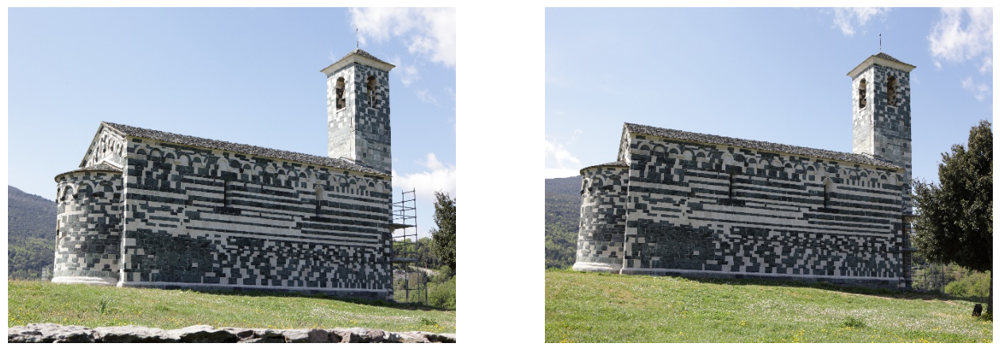

In [6]:
img1 = cv.imread(ROOT + 'feature/DPP_0010.JPG')
img2 = cv.imread(ROOT + 'feature/DPP_0011.JPG')

plt.figure(figsize=(16,8))
plt.subplot(121)
plt.imshow(img1[:,:,::-1])
plt.axis('off')
plt.subplot(122)
plt.imshow(img2[:,:,::-1])
plt.axis('off')
plt.show()

### ORB feature 얻기

지난 과제를 통해 실습한 ORB feature를 구한다.

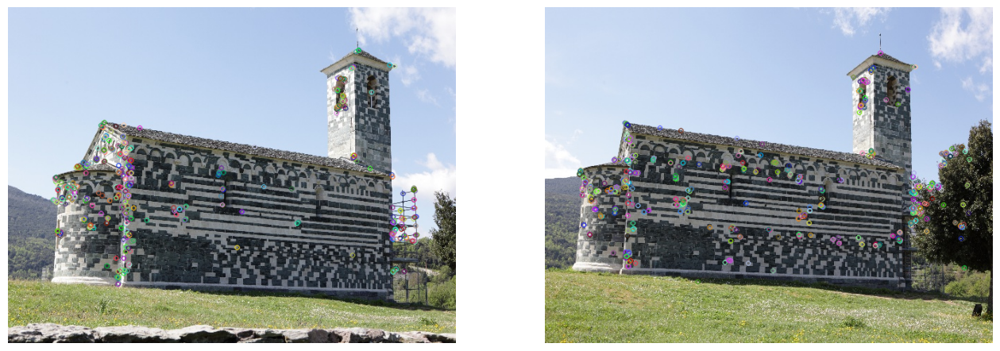

In [28]:
img1 = cv.imread(ROOT + 'feature/DPP_0010.JPG')
img2 = cv.imread(ROOT + 'feature/DPP_0011.JPG')

gray1 = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
gray2 = cv.cvtColor(img2, cv.COLOR_BGR2GRAY)

# To-do : 각 이미지에 대해 orb feature를 얻고 시각화하기
retval = cv.ORB_create()
key_point1, desc1 = retval.detectAndCompute(gray1,None)
key_point2, desc2 = retval.detectAndCompute(gray2,None)
orb_kps_img1 = cv.drawKeypoints(img1, key_point1, None)
orb_kps_img2 = cv.drawKeypoints(img2, key_point2, None)

plt.figure(figsize=(16,8))
plt.subplot(121)
plt.imshow(orb_kps_img1[:,:,::-1])
plt.axis('off')
plt.subplot(122)
plt.imshow(orb_kps_img2[:,:,::-1])
plt.axis('off')
plt.show()

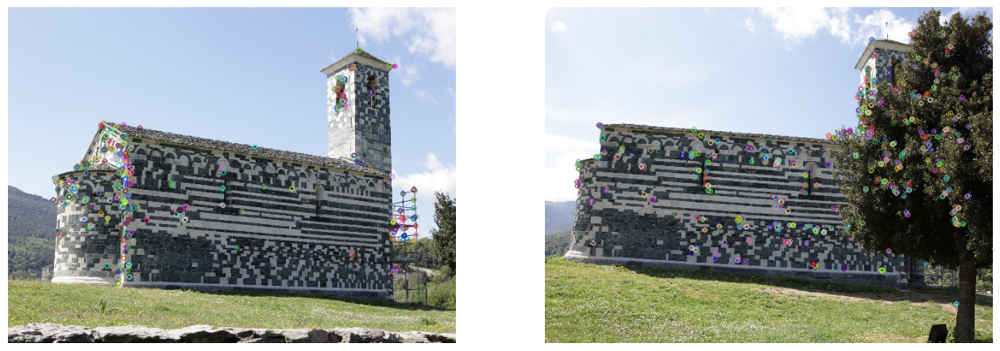

In [8]:
img3 = cv.imread(ROOT + 'feature/DPP_0010.JPG')
img4 = cv.imread(ROOT + 'feature/DPP_0013.JPG')

gray3 = cv.cvtColor(img3, cv.COLOR_BGR2GRAY)
gray4 = cv.cvtColor(img4, cv.COLOR_BGR2GRAY)

# To-do : 각 이미지에 대해 orb feature를 얻고 시각화하기
retval = cv.ORB_create()
key_point3, desc3 = retval.detectAndCompute(gray3,None)
key_point4, desc4 = retval.detectAndCompute(gray4,None)
orb_kps_img3 = cv.drawKeypoints(img3, key_point3, None)
orb_kps_img4 = cv.drawKeypoints(img4, key_point4, None)

plt.figure(figsize=(16,8))
plt.subplot(121)
plt.imshow(orb_kps_img3[:,:,::-1])
plt.axis('off')
plt.subplot(122)
plt.imshow(orb_kps_img4[:,:,::-1])
plt.axis('off')
plt.show()

### ORB descriptor 구하기

**과제**
- 찾은 feature에 대해 descriptor를 구한다.

관련 함수

- `	keypoints, descriptors	=	cv.Feature2D.compute(	image, keypoints[, descriptors]	)`
- `keypoints, descriptors	=	cv.Feature2D.detectAndCompute(	image, mask[, descriptors[, useProvidedKeypoints]]	)`

In [29]:
# To-do
key_point1, desc1 = retval.detectAndCompute(gray1,None)
key_point2, desc2 = retval.detectAndCompute(gray2,None)

array([[ 38, 178, 218, ..., 105,  13, 151],
       [ 31,  92,  38, ..., 253, 116, 113],
       [ 90,  96,  89, ..., 128,  39, 251],
       ...,
       [106, 188, 220, ...,  13, 207,  19],
       [162,  77,  18, ...,  61,  61, 142],
       [ 11, 151, 243, ..., 207, 169, 213]], dtype=uint8)
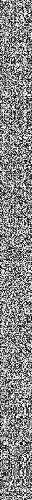

In [10]:
desc1

array([[ 68, 164,   6, ...,  75,  33, 128],
       [163, 245,  19, ...,  30, 137, 157],
       [ 50, 174, 104, ..., 134,  71,  95],
       ...,
       [106, 186, 184, ...,   4,  78, 223],
       [ 46, 187, 106, ..., 134, 127, 215],
       [ 91, 179, 169, ..., 148, 190, 127]], dtype=uint8)
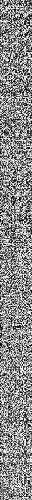

In [11]:
desc2

### Brute-Force Matching

**과제**
- feature matching을 진행하고 시각화한다.
- matcher에 cycle consistency를 추가하여 두 이미지를 비교한다.

관련 함수

`	<BFMatcher object>	=	cv.BFMatcher(	[, normType[, crossCheck]]	)
`


In [12]:
# To-do
img1_rgb = cv.cvtColor(img1, cv.COLOR_BGR2RGB)
img2_rgb = cv.cvtColor(img2, cv.COLOR_BGR2RGB)
# BFMatcher 생성, Hamming 거리, 상호 체크
matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)
# 매칭 계산
matches = matcher.match(desc1,desc2)
matches = sorted(matches, key = lambda x:x.distance) #거리기준으로 정렬하기
res = cv.drawMatches(img1_rgb,key_point1,img2_rgb, key_point2,matches[:100],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
#image_1은 특징점들이 검출된 원본이미지, key_point1은 image_1에서 검출된 특징점 리스트
#image_2은 특징점들이 검출된 원본이미지, key_point2은 image_2에서 검출된 특징점 리스트
#두 이미지간의 특징점 매칭 결과를 나타내는 리스트인 matches리스트에서 100개의 매칭결과만 사용해보기
# flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS: 매칭되지 않은 특징점은 표시하지 않는 옵션

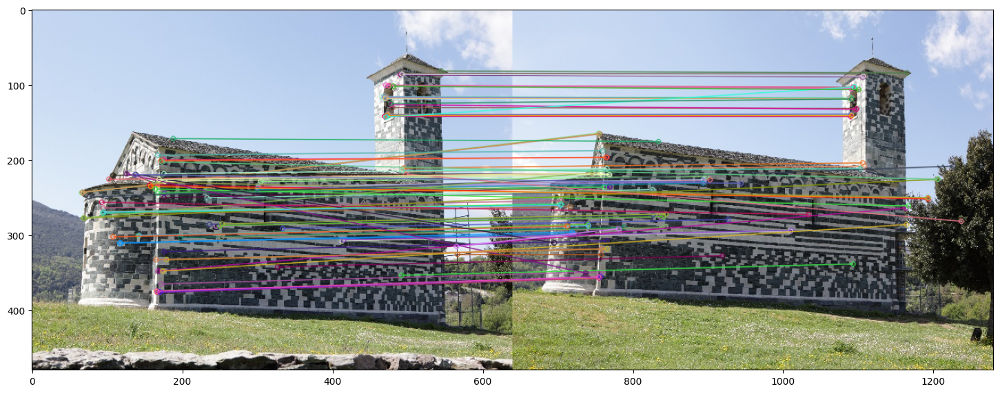

In [13]:
# 결과 이미지 예시
plt.figure(figsize=(18,18))
plt.imshow(res)
plt.show()

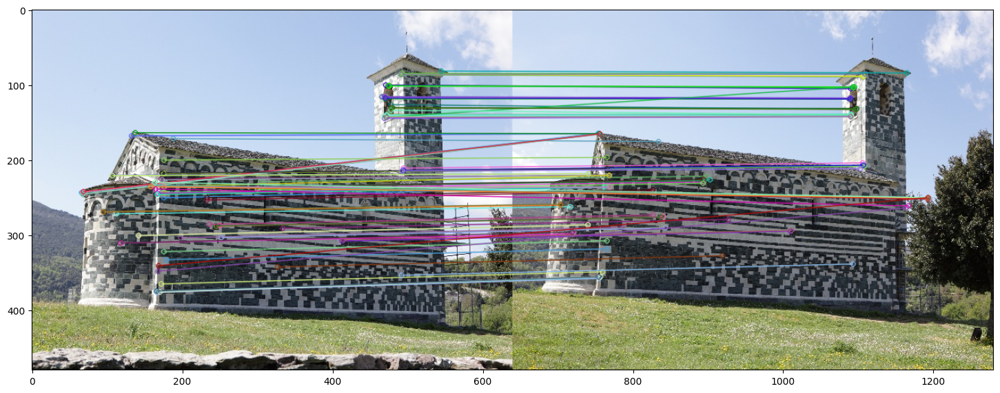

In [30]:
# To-do
img1_rgb = cv.cvtColor(img1, cv.COLOR_BGR2RGB)
img2_rgb = cv.cvtColor(img2, cv.COLOR_BGR2RGB)

matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=False) #False인 경우

matches = matcher.match(desc1,desc2)
matches = sorted(matches, key = lambda x:x.distance)
res = cv.drawMatches(img1_rgb,key_point1,img2_rgb, key_point2,matches[:100],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(18,18))
plt.imshow(res)
plt.show()

In [31]:
key_point3, desc3 = retval.detectAndCompute(gray3,None)
key_point4, desc4 = retval.detectAndCompute(gray4,None)

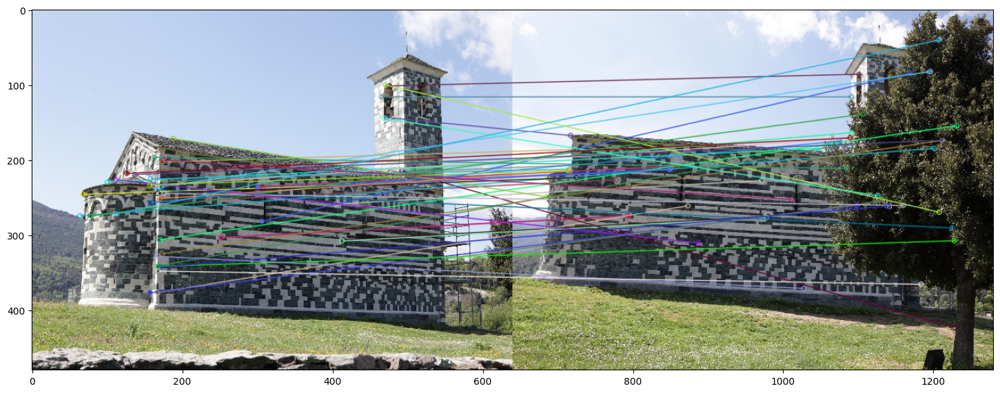

In [35]:
img3_rgb = cv.cvtColor(img3, cv.COLOR_BGR2RGB)
img4_rgb = cv.cvtColor(img4, cv.COLOR_BGR2RGB)

matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)

matches = matcher.match(desc3,desc4)
matches = sorted(matches, key = lambda x:x.distance)
res = cv.drawMatches(img3_rgb,key_point3,img4_rgb, key_point4,matches[:50],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(18,18))
plt.imshow(res)
plt.show()

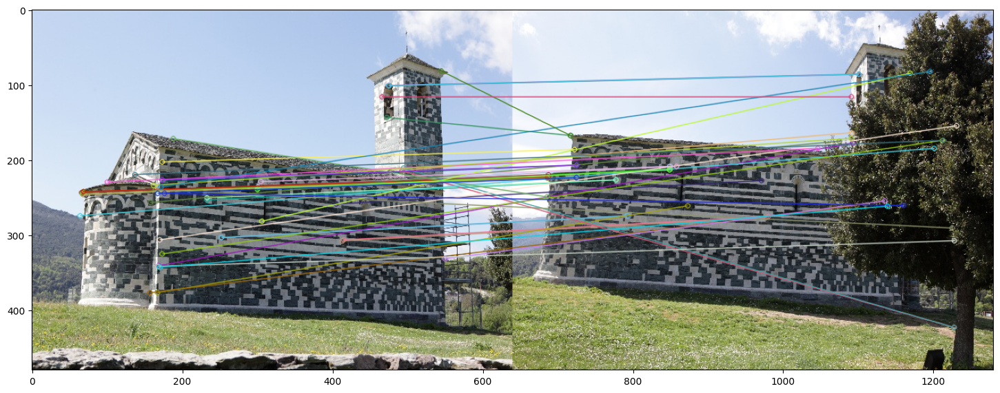

In [36]:
img3_rgb = cv.cvtColor(img3, cv.COLOR_BGR2RGB)
img4_rgb = cv.cvtColor(img4, cv.COLOR_BGR2RGB)

matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=False) #False인 경우

matches = matcher.match(desc3,desc4)
matches = sorted(matches, key = lambda x:x.distance)
res = cv.drawMatches(img3_rgb,key_point3,img4_rgb, key_point4,matches[:50],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(18,18))
plt.imshow(res)
plt.show()

### SIFT feature 얻기

이번 단계에서는 SIFT feature에 대해 매칭을 진행한다.

지난 과제를 통해 실습한 SIFT feature를 구한다.

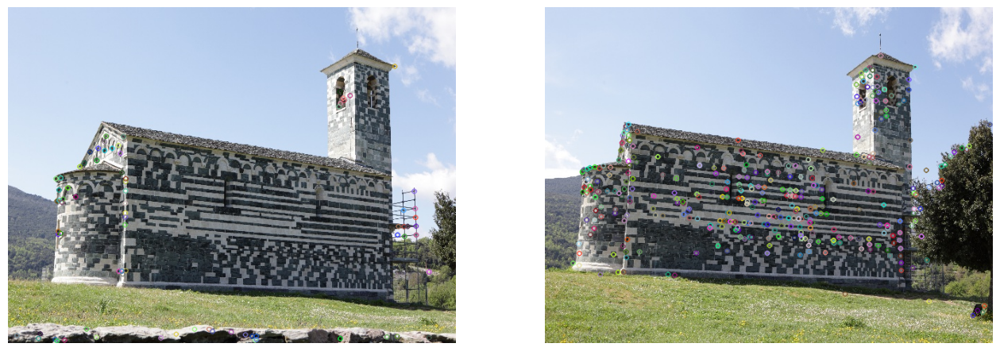

In [16]:
img1 = cv.imread( ROOT + 'feature/DPP_0010.JPG')
img2 = cv.imread( ROOT + 'feature/DPP_0011.JPG')

gray1 = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
gray2 = cv.cvtColor(img2, cv.COLOR_BGR2GRAY)

retval = cv.SIFT_create(nfeatures=100, nOctaveLayers=3, contrastThreshold=0.03,edgeThreshold=70, sigma=1.6)
key_point1, desc1 = retval.detectAndCompute(gray1, None)
sift_kps_img1 = cv.drawKeypoints(img1, key_point1, None)
sift_kps_img1 = cv.cvtColor(sift_kps_img1, cv.COLOR_BGR2RGB)

retval = cv.SIFT_create(nfeatures=500, nOctaveLayers=3, contrastThreshold=0.03,edgeThreshold=70, sigma=1.6)
key_point2, desc2 = retval.detectAndCompute(gray2, None)
sift_kps_img2 = cv.drawKeypoints(img2, key_point2, None)
sift_kps_img2 = cv.cvtColor(sift_kps_img2, cv.COLOR_BGR2RGB)

plt.figure(figsize=(16,8))
plt.subplot(121)
plt.imshow(sift_kps_img1)
plt.axis('off')
plt.subplot(122)
plt.imshow(sift_kps_img2)
plt.axis('off')
plt.show()

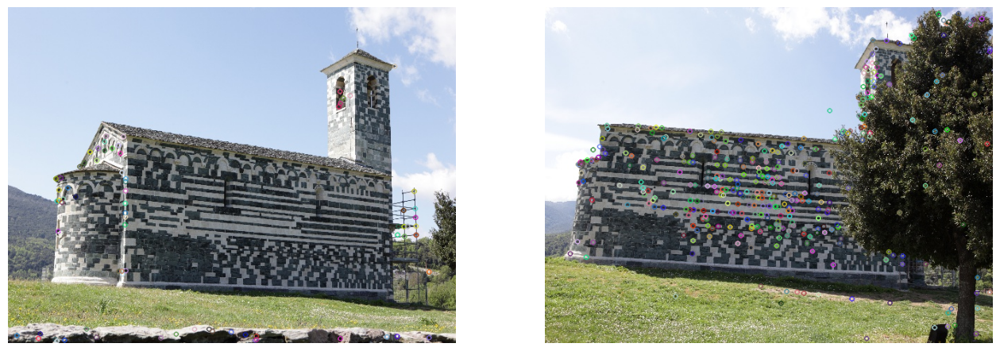

In [17]:
img3 = cv.imread(ROOT + 'feature/DPP_0010.JPG')
img4 = cv.imread(ROOT + 'feature/DPP_0013.JPG')

gray3 = cv.cvtColor(img3, cv.COLOR_BGR2GRAY)
gray4 = cv.cvtColor(img4, cv.COLOR_BGR2GRAY)

retval = cv.SIFT_create(nfeatures=100, nOctaveLayers=3, contrastThreshold=0.03,edgeThreshold=70, sigma=1.6)
key_point3, desc3 = retval.detectAndCompute(gray3, None)
sift_kps_img3 = cv.drawKeypoints(img3, key_point3, None)
sift_kps_img3 = cv.cvtColor(sift_kps_img3, cv.COLOR_BGR2RGB)

retval = cv.SIFT_create(nfeatures=500, nOctaveLayers=3, contrastThreshold=0.03,edgeThreshold=70, sigma=1.6)
key_point4, desc4 = retval.detectAndCompute(gray4, None)
sift_kps_img4 = cv.drawKeypoints(img4, key_point4, None)
sift_kps_img4 = cv.cvtColor(sift_kps_img4, cv.COLOR_BGR2RGB)

plt.figure(figsize=(16,8))
plt.subplot(121)
plt.imshow(sift_kps_img3)
plt.axis('off')
plt.subplot(122)
plt.imshow(sift_kps_img4)
plt.axis('off')
plt.show()

### SIFT descriptor 구하기

**과제**
- 찾은 feature에 대해 descriptor를 구한다.

관련 함수

- `	keypoints, descriptors	=	cv.Feature2D.compute(	image, keypoints[, descriptors]	)`
- `keypoints, descriptors	=	cv.Feature2D.detectAndCompute(	image, mask[, descriptors[, useProvidedKeypoints]]	)`

In [18]:
# To-do
key_point1, desc1 = retval.detectAndCompute(gray1, None)
key_point2, desc2 = retval.detectAndCompute(gray2, None)

### Brute-Force Matching

**과제**
- feature matching을 진행하고 시각화한다.
- matcher에 cycle consistency를 추가하여 두 이미지를 비교한다.

관련 함수

`	<BFMatcher object>	=	cv.BFMatcher(	[, normType[, crossCheck]]	)
`


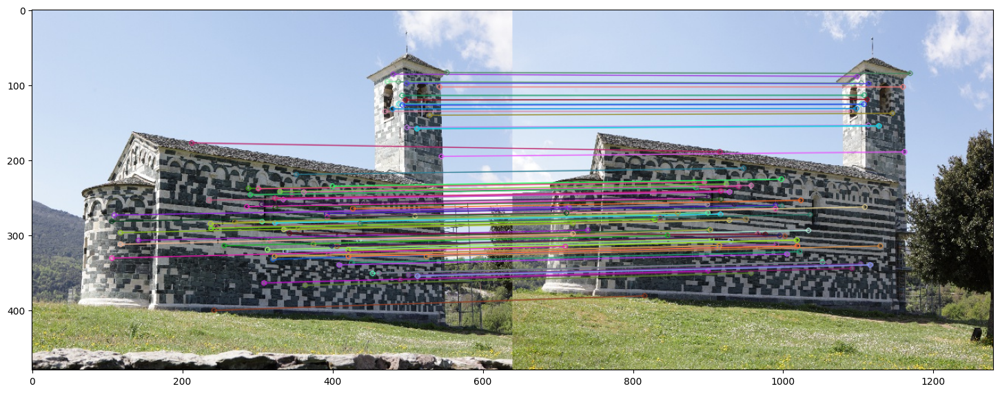

In [19]:
img1_rgb = cv.cvtColor(img1, cv.COLOR_BGR2RGB)
img2_rgb = cv.cvtColor(img2, cv.COLOR_BGR2RGB)

matcher = cv.BFMatcher(cv.NORM_L2, crossCheck=True) #위치가 더 정확한듯

matches = matcher.match(desc1,desc2)
matches = sorted(matches, key = lambda x:x.distance)
res = cv.drawMatches(img1_rgb,key_point1,img2_rgb, key_point2,matches[:100],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(18,18))
plt.imshow(res)
plt.show()

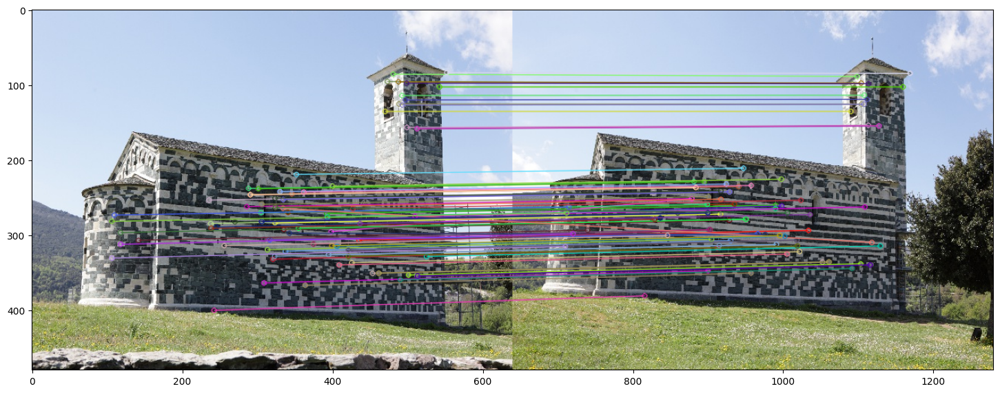

In [20]:
img1_rgb = cv.cvtColor(img1, cv.COLOR_BGR2RGB)
img2_rgb = cv.cvtColor(img2, cv.COLOR_BGR2RGB)

matcher = cv.BFMatcher(cv.NORM_L2, crossCheck=False)

matches = matcher.match(desc1,desc2)
matches = sorted(matches, key = lambda x:x.distance)
res = cv.drawMatches(img1_rgb,key_point1,img2_rgb, key_point2,matches[:100],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(18,18))
plt.imshow(res)
plt.show()

In [21]:
key_point3, desc3 = retval.detectAndCompute(gray3,None)
key_point4, desc4 = retval.detectAndCompute(gray4,None)

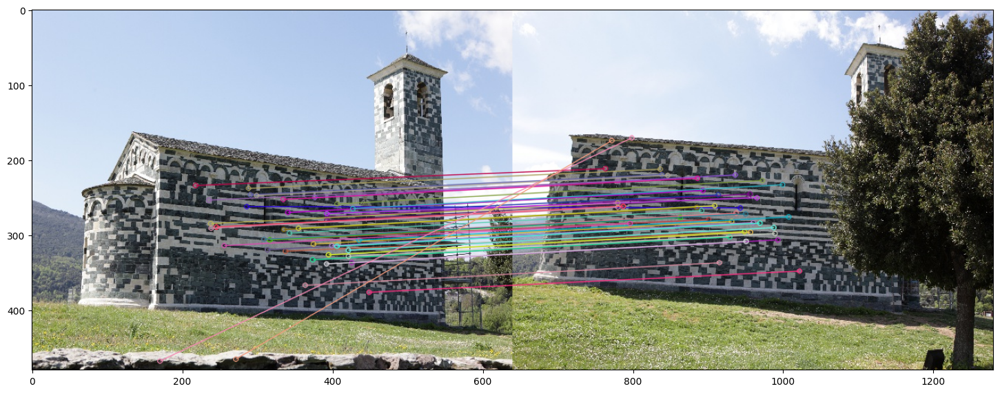

In [26]:
img3_rgb = cv.cvtColor(img3, cv.COLOR_BGR2RGB)
img4_rgb = cv.cvtColor(img4, cv.COLOR_BGR2RGB)

matcher = cv.BFMatcher(cv.NORM_L2, crossCheck=True)

matches = matcher.match(desc3,desc4)
matches = sorted(matches, key = lambda x:x.distance)
res = cv.drawMatches(img3_rgb,key_point3,img4_rgb, key_point4,matches[:50],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(18,18))
plt.imshow(res)
plt.show()

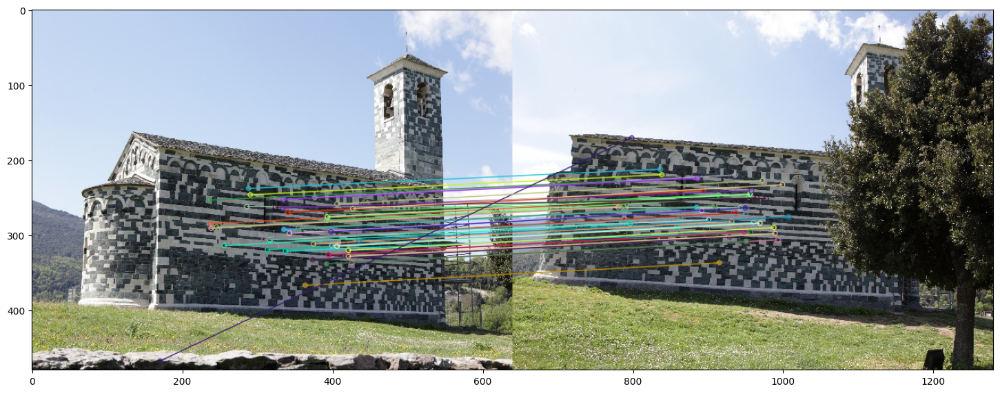

In [25]:
img3_rgb = cv.cvtColor(img3, cv.COLOR_BGR2RGB)
img4_rgb = cv.cvtColor(img4, cv.COLOR_BGR2RGB)

matcher = cv.BFMatcher(cv.NORM_L2, crossCheck=False) #이 경우는 False인게 더 나아보임

matches = matcher.match(desc3,desc4)
matches = sorted(matches, key = lambda x:x.distance)
res = cv.drawMatches(img3_rgb,key_point3,img4_rgb, key_point4,matches[:50],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(18,18))
plt.imshow(res)
plt.show()

## 다른 이미지에도 적용해보기

위 실습을 바탕으로 주어진 이미지 외에 다른 이미지에도 feature matching을 진행한다.

- 한 물체를 다른 각도에서 찍은 이미지 2장을 불러온다. (직접 찍은 사진, 인터넷에서 다운로드한 사진 모두 가능)
- 이미지들에 대해 feature matching을 진행한다.
  - feature descriptor는 자유롭게 하나를 선택한다.
  - cycle consistency를 추가한 것과 아닌 것을 비교한다.


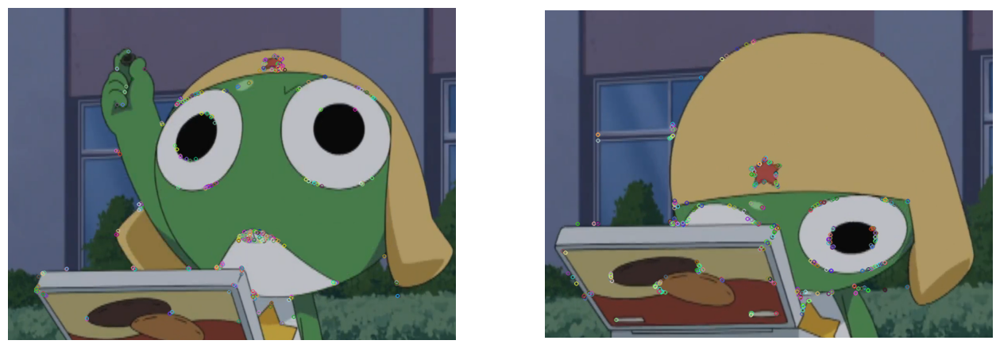

In [37]:
# To-do
img5 = cv.imread(ROOT + 'feature/frog1.png')
img6 = cv.imread(ROOT + 'feature/frog2.png')

gray5 = cv.cvtColor(img5, cv.COLOR_BGR2GRAY)
gray6 = cv.cvtColor(img6, cv.COLOR_BGR2GRAY)

# To-do : 각 이미지에 대해 orb feature를 얻고 시각화하기
retval = cv.ORB_create()
key_point5, desc5 = retval.detectAndCompute(gray5,None)
key_point6, desc6 = retval.detectAndCompute(gray6,None)
orb_kps_img5 = cv.drawKeypoints(img5, key_point5, None)
orb_kps_img6 = cv.drawKeypoints(img6, key_point6, None)

plt.figure(figsize=(16,8))
plt.subplot(121)
plt.imshow(orb_kps_img5[:,:,::-1])
plt.axis('off')
plt.subplot(122)
plt.imshow(orb_kps_img6[:,:,::-1])
plt.axis('off')
plt.show()

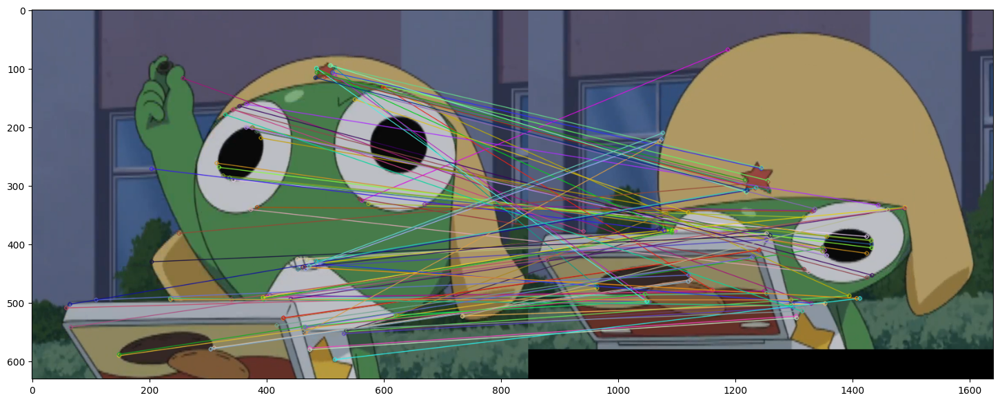

In [38]:
key_point5, desc5 = retval.detectAndCompute(gray5,None)
key_point6, desc6 = retval.detectAndCompute(gray6,None)

img5_rgb = cv.cvtColor(img5, cv.COLOR_BGR2RGB)
img6_rgb = cv.cvtColor(img6, cv.COLOR_BGR2RGB)

matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)

matches = matcher.match(desc5,desc6)
matches = sorted(matches, key = lambda x:x.distance)
res = cv.drawMatches(img5_rgb,key_point5,img6_rgb, key_point6,matches[:100],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(18,18))
plt.imshow(res)

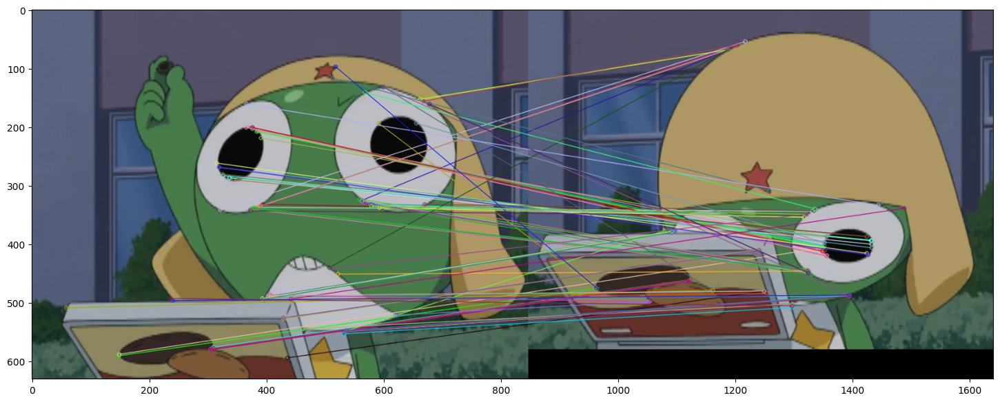

In [39]:
key_point5, desc5 = retval.detectAndCompute(gray5,None)
key_point6, desc6 = retval.detectAndCompute(gray6,None)

img5_rgb = cv.cvtColor(img5, cv.COLOR_BGR2RGB)
img6_rgb = cv.cvtColor(img6, cv.COLOR_BGR2RGB)

matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=False) #False인 경우

matches = matcher.match(desc5,desc6)
matches = sorted(matches, key = lambda x:x.distance)
res = cv.drawMatches(img5_rgb,key_point5,img6_rgb, key_point6,matches[:100],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(18,18))
plt.imshow(res)

#cycle consistency를 추가하지 않으니 케로로 이마 별 부분이 매칭이 잘 안됨.

## 추가 점수 과제

- opencv에서는`BFMathcer` 외의 다른 matcher를 제공한다. 이러한 다른 matcher를 이용해 같은 과정을 진행한다.
- 해당 matcher에 대해 간단히 조사해 보고, 각 과정에 대한 설명도 기술한다.

## FlannBasedMatcher
BFMatcher는 모든 desc를 조사하므로 이미지 사이즈가 클 경우 느리다.
FlannBaseMatcher는 이웃하는 desc끼리 조사하여 비교적 빠르며, 인덱스 파라미터와 검색 파라미터를 활용하여 이웃하는 desc가 무엇인지 탐색한다.
큰 이미지에서 특성들을 매칭할때 효용이 있다.


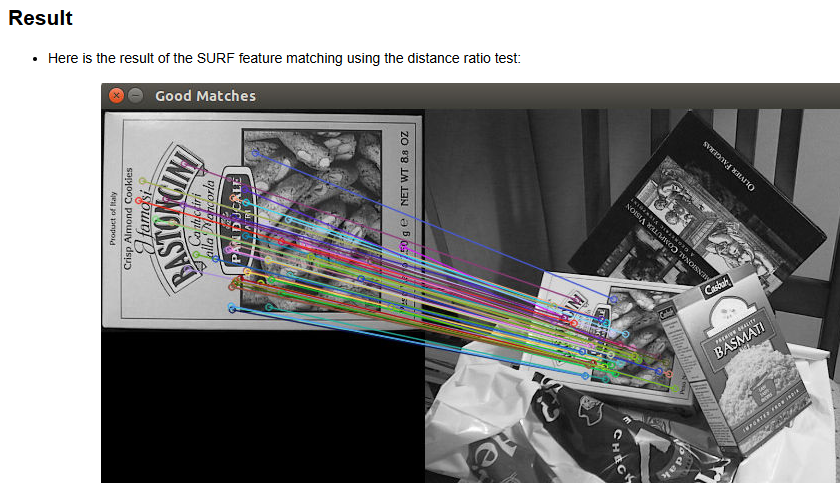

In [ ]:
#참고: https://bkshin.tistory.com/entry/OpenCV-28-%ED%8A%B9%EC%A7%95-%EB%A7%A4%EC%B9%ADFeature-Matching
#참고: https://docs.opencv.org/3.4/d5/d6f/tutorial_feature_flann_matcher.html

In [40]:
image_1 = cv.imread(ROOT + 'feature/ping1.png')
image_2 = cv.imread(ROOT + 'feature/ping2.png')

image_1 = cv.cvtColor(image_1, cv.COLOR_BGR2RGB)
image_2 = cv.cvtColor(image_2, cv.COLOR_BGR2RGB)

gray_1 = cv.cvtColor(image_1, cv.COLOR_BGR2GRAY)
gray_2 = cv.cvtColor(image_2, cv.COLOR_BGR2GRAY)

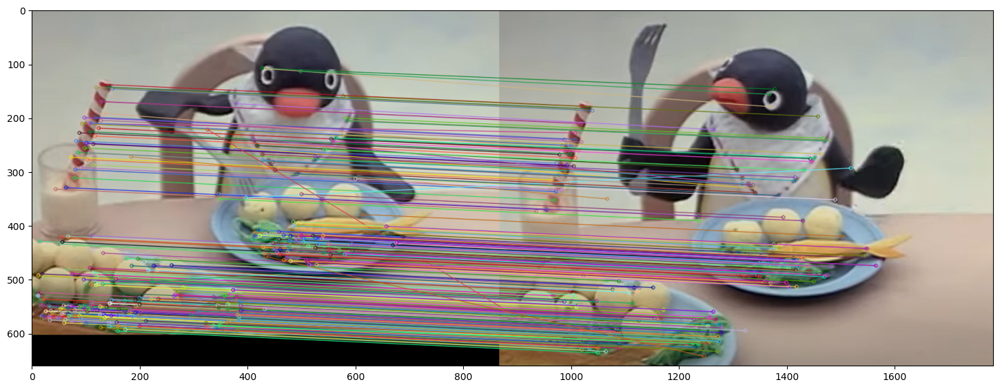

In [42]:
# To-do
# FLANN 매칭을 위한 알고리즘 설정
FLANN_INDEX_KDTREE = 1  # KD-Tree 알고리즘을 사용하도록 설정
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)  # KD-Tree 매개변수 설정

# 매칭 검색 매개변수 설정
search_params = dict(checks=50)  # 매칭을 위한 체크 횟수 설정
flann = cv.FlannBasedMatcher(index_params, search_params)  # FLANN 매처 생성

sift = cv.SIFT_create()

key_point_1, desc_1 = sift.detectAndCompute(image_1, None)
key_point_2, desc_2 = sift.detectAndCompute(image_2, None)

# knnMatch를 통해 k=2로 매칭
matches = flann.knnMatch(desc_1, desc_2, k=2)
matchesMask = [[0,0] for i in range(len(matches))]  # 매칭 마스크 초기화

# 매칭 결과 중 좋은 매칭만 선택
for i, (m, n) in enumerate(matches):
    if m.distance < 0.8 * n.distance:
        matchesMask[i] = [1, 0]  # 좋은 매칭으로 마스크 설정

# 매칭 결과를 그리기 위해 작업
draw_params = dict(
    matchesMask = matchesMask,  # 매칭 마스크 적용
    flags = cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS  # 단일 포인트는 그리지 않음
)

# 두 이미지 간의 매칭 결과를 그리기
res = cv.drawMatchesKnn(image_1, key_point_1, image_2, key_point_2, matches, None, **draw_params)

plt.figure(figsize=(18, 18))
plt.imshow(res)
plt.show()
